# Mod 4 Project - Starter Notebook

This notebook has been provided to you so that you can make use of the following starter code to help with the trickier parts of preprocessing the Zillow dataset. 

The notebook contains a rough outline the general order you'll likely want to take in this project. You'll notice that most of the areas are left blank. This is so that it's more obvious exactly when you should make use of the starter code provided for preprocessing. 

**_NOTE:_** The number of empty cells are not meant to infer how much or how little code should be involved in any given step--we've just provided a few for your convenience. Add, delete, and change things around in this notebook as needed!

# Some Notes Before Starting

This project will be one of the more challenging projects you complete in this program. This is because working with Time Series data is a bit different than working with regular datasets. In order to make this a bit less frustrating and help you understand what you need to do (and when you need to do it), we'll quickly review the dataset formats that you'll encounter in this project. 

## Wide Format vs Long Format

If you take a look at the format of the data in `zillow_data.csv`, you'll notice that the actual Time Series values are stored as separate columns. Here's a sample: 

<img src='~/../images/df_head.png'>

You'll notice that the first seven columns look like any other dataset you're used to working with. However, column 8 refers to the median housing sales values for April 1996, column 9 for May 1996, and so on. This This is called **_Wide Format_**, and it makes the dataframe intuitive and easy to read. However, there are problems with this format when it comes to actually learning from the data, because the data only makes sense if you know the name of the column that the data can be found it. Since column names are metadata, our algorithms will miss out on what dates each value is for. This means that before we pass this data to our ARIMA model, we'll need to reshape our dataset to **_Long Format_**. Reshaped into long format, the dataframe above would now look like:

<img src='~/../images/melted1.png'>

There are now many more rows in this dataset--one for each unique time and zipcode combination in the data! Once our dataset is in this format, we'll be able to train an ARIMA model on it. The method used to convert from Wide to Long is `pd.melt()`, and it is common to refer to our dataset as 'melted' after the transition to denote that it is in long format. 

# Helper Functions Provided

Melting a dataset can be tricky if you've never done it before, so you'll see that we have provided a sample function, `melt_data()`, to help you with this step below. Also provided is:

* `get_datetimes()`, a function to deal with converting the column values for datetimes as a pandas series of datetime objects
* Some good parameters for matplotlib to help make your visualizations more readable. 

Good luck!


# Step 1: Load the Data/Filtering for Chosen Zipcodes

In [1]:
# def melt_data(df): # BAD PROVIDED FUNCTION
#     melted = pd.melt(df, id_vars=['RegionName', 'City', 'State', 'Metro', 'CountyName'], var_name='time')
#     melted['time'] = pd.to_datetime(melted['time'], infer_datetime_format=True)
#     melted = melted.dropna(subset=['value'])
#     return melted.groupby('time').aggregate({'value':'mean'})

# melt_df = melt_data(df)

In [2]:
# !pip install -U fsds_100719
from fsds_100719.imports import *
from plotly import express as px
import plotly.graph_objects as go

fsds_1007219  v0.6.1 loaded.  Read the docs: https://fsds.readthedocs.io/en/latest/ 


Handle,Package,Description
dp,IPython.display,Display modules with helpful display and clearing commands.
fs,fsds_100719,Custom data science bootcamp student package
mpl,matplotlib,Matplotlib's base OOP module with formatting artists
plt,matplotlib.pyplot,Matplotlib's matlab-like plotting module
np,numpy,scientific computing with Python
pd,pandas,High performance data structures and tools
sns,seaborn,High-level data visualization library based on matplotlib


In [3]:

def load_ts_american_sex_frequency(read_csv_kwds={}):
    url = 'https://raw.githubusercontent.com/jirvingphd/fsds_100719/master/fsds_100719/data/Americans%20Sex%20Frequency.xlsx'
    import pandas as pd
    
    return pd.read_excel(url,**read_csv_kwds)
# dfs = load_ts_american_sex_frequency()
dfs = fs.datasets.load_ts_std_cases()
dfs

,Disease,Disease Code,State,Year,Gender,Age,Age Code,STD Cases,Population,Rate per 100K
0,Chlamydia,274.0,Alabama,1996.0,Male,0-14 years,0-14,25.0,468394.0,5.34
1,Chlamydia,274.0,Alabama,1996.0,Male,15-19 years,15-19,164.0,165920.0,98.84
2,Chlamydia,274.0,Alabama,1996.0,Male,20-24 years,20-24,193.0,152848.0,126.27
3,Chlamydia,274.0,Alabama,1996.0,Male,25-29 years,25-29,88.0,152778.0,57.60
4,Chlamydia,274.0,Alabama,1996.0,Male,30-34 years,30-34,55.0,155850.0,35.29
...,...,...,...,...,...,...,...,...,...,...
42675,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42676,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
42678,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
dfs.columns

Index(['Disease', 'Disease Code', 'State', 'Year', 'Gender', 'Age', 'Age Code',
       'STD Cases', 'Population', 'Rate per 100K'],
      dtype='object')

In [5]:
dfs = dfs.loc[dfs['Disease']=='Chlamydia']
dfs

,Disease,Disease Code,State,Year,Gender,Age,Age Code,STD Cases,Population,Rate per 100K
0,Chlamydia,274.0,Alabama,1996.0,Male,0-14 years,0-14,25.0,468394.0,5.34
1,Chlamydia,274.0,Alabama,1996.0,Male,15-19 years,15-19,164.0,165920.0,98.84
2,Chlamydia,274.0,Alabama,1996.0,Male,20-24 years,20-24,193.0,152848.0,126.27
3,Chlamydia,274.0,Alabama,1996.0,Male,25-29 years,25-29,88.0,152778.0,57.60
4,Chlamydia,274.0,Alabama,1996.0,Male,30-34 years,30-34,55.0,155850.0,35.29
...,...,...,...,...,...,...,...,...,...,...
31439,Chlamydia,274.0,Wyoming,2014.0,Female,20-24 years,20-24,542.0,20169.0,2687.29
31440,Chlamydia,274.0,Wyoming,2014.0,Female,25-29 years,25-29,229.0,19383.0,1181.45
31441,Chlamydia,274.0,Wyoming,2014.0,Female,30-34 years,30-34,76.0,19451.0,390.73
31442,Chlamydia,274.0,Wyoming,2014.0,Female,35-39 years,35-39,27.0,16736.0,161.33


In [6]:
dft = dfs.pivot_table(index='Year',columns=['Gender','Age'],values='Rate per 100K')

In [7]:
dft.index = pd.to_datetime(dft.index.astype('int'),format='%Y')
dft

Gender         Female                                                     \
Age        0-14 years  15-19 years  20-24 years  25-29 years 30-34 years   
Year                                                                       
1996-01-01  47.132600  1850.777400  1445.763000   468.699800  165.157800   
1997-01-01  49.960200  1978.905000  1595.756200   512.912600  179.768600   
1998-01-01  52.932353  2228.799804  1825.701569   590.323529  199.659020   
1999-01-01  49.973922  2265.462941  1950.365490   638.800784  218.837843   
2000-01-01  49.342941  2249.608627  2020.035686   673.010588  239.963529   
2001-01-01  52.428235  2415.177255  2165.812745   761.511765  261.079216   
2002-01-01  51.746275  2556.035882  2310.354510   831.830588  290.070196   
2003-01-01  50.911176  2605.167843  2378.731961   889.815294  316.495490   
2004-01-01  50.218039  2714.699804  2513.039216   978.677647  339.667843   
2005-01-01  49.481765  2734.962745  2614.776078  1011.652549  373.082941   
2006-01-01  45.379412  2766.919216  2748.672353  1057.256863  401.208824   
2007-01-01  45.434706  2930.548627  2892.564314  1115.206275  443.427647   
2008-01-01  47.106078  3211.388235  3084.779216  1172.775098  469.110980   
2009-01-01  44.332941  3254.844118  3109.710588  1173.964902  486.744510   
2010-01-01  44.840588  3235.160784  3265.444118  1210.893333  495.603725   
2011-01-01  48.657647  3444.858235  3503.744510  1276.469412  526.404118   
2012-01-01  45.911765  3374.511961  3553.047255  1351.946471  546.120588   
2013-01-01  40.940588  3118.667255  3543.557451  1392.943137  581.525686   
2014-01-01  38.065686  3014.349804  3605.196863  1496.365686  620.579412   

Gender                                  Male                           \
Age        35-39 years  40+ years 0-14 years 15-19 years  20-24 years   
Year                                                                    
1996-01-01   72.355000  11.501200   4.234200  207.044400   291.557400   
1997-01-01   72.416600  12.724600   4.495833  232.185200   338.038400   
1998-01-01   81.973725  12.440980   5.153600  281.386471   410.915490   
1999-01-01   88.735490  12.606667   4.799388  300.417843   456.421765   
2000-01-01   94.094706  13.015098   4.882083  332.415882   508.186667   
2001-01-01  105.158431  14.008824   5.069792  355.368824   569.329020   
2002-01-01  115.457647  15.443725   6.286735  392.510588   655.611373   
2003-01-01  124.084902  15.404118   4.841600  412.363333   682.847255   
2004-01-01  136.087647  17.324510   4.922245  450.562157   759.689804   
2005-01-01  148.383529  18.032549   5.446200  491.796275   809.977451   
2006-01-01  161.361765  19.703137   5.403333  529.129804   871.862157   
2007-01-01  176.775098  21.067647   5.578980  613.561961   958.017451   
2008-01-01  194.158039  23.389804   6.525800  710.777059  1075.106078   
2009-01-01  195.701961  22.684706   5.733265  746.511373  1122.886471   
2010-01-01  204.979216  23.535098   6.159000  766.088824  1213.714706   
2011-01-01  227.991961  25.307451   6.412353  831.206275  1323.232745   
2012-01-01  246.414706  27.558824   6.468431  806.979608  1349.789216   
2013-01-01  268.639804  29.000196   6.057083  750.409804  1332.766471   
2014-01-01  285.653922  30.825098   5.168039  721.652353  1367.578824   

Gender                                                     
Age        25-29 years 30-34 years 35-39 years  40+ years  
Year                                                       
1996-01-01  129.797600   56.727200   27.632800   6.153200  
1997-01-01  150.558600   65.340800   33.579000   7.086400  
1998-01-01  184.037647   82.781176   41.877451   8.110588  
1999-01-01  210.544902   91.944118   47.612745   9.511765  
2000-01-01  239.759216  109.315490   54.453333  10.374314  
2001-01-01  280.262941  122.475294   64.410784  12.436863  
2002-01-01  329.788039  146.849608   75.961373  14.442157  
2003-01-01  356.739216  162.897059   81.568431  16.054314  
2004-01-01  399.063333  183.341961   92.177059  17.634706  


In [8]:
dft.columns

MultiIndex([('Female',  '0-14 years'),
            ('Female', '15-19 years'),
            ('Female', '20-24 years'),
            ('Female', '25-29 years'),
            ('Female', '30-34 years'),
            ('Female', '35-39 years'),
            ('Female',   '40+ years'),
            (  'Male',  '0-14 years'),
            (  'Male', '15-19 years'),
            (  'Male', '20-24 years'),
            (  'Male', '25-29 years'),
            (  'Male', '30-34 years'),
            (  'Male', '35-39 years'),
            (  'Male',   '40+ years')],
           names=['Gender', 'Age'])

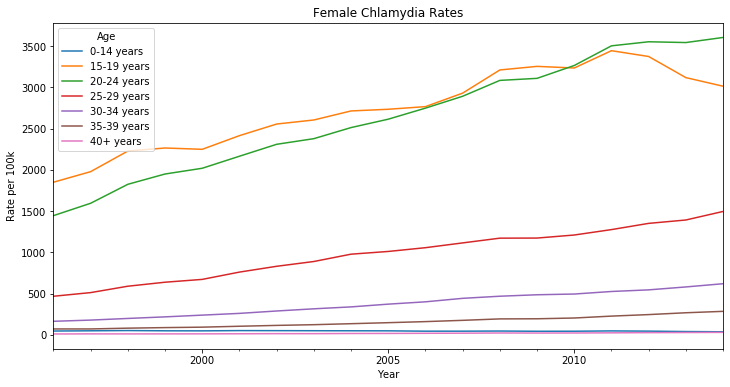

In [9]:
ax = dft['Female'].plot()

ax.set(**dict(ylabel= 'Rate per 100k',
              title='Female Chlamydia Rates'))
            
fig = ax.get_figure()
fig.set_size_inches(12,6)
fig;

In [72]:
# locator = mpl.dates.AutoDateLocator()
# monthsFmt = mpl.dates.DateFormatter('%Y-%b')
# ax.xaxis.set_major_locator(locator)
# ax.xaxis.set_major_formatter(monthsFmt)

# fig

In [73]:
# import matplotlib.dates as mdates
# # Instantiate Locators to be used
# years = mdates.YearLocator()   # every year
# months = mdates.MonthLocator()#interval=2)  # every month
# quarters = mdates.MonthLocator(interval=3)#interval=2)  # every month

# # Define various date formatting to be used
# monthsFmt = mdates.DateFormatter('%Y-%b')
# yearsFmt = mdates.DateFormatter('%Y') #'%Y')
# yr_mo_day_fmt = mdates.DateFormatter('%Y-%m')
# monthDayFmt = mdates.DateFormatter('%m-%d-%y')


# ## AX2 SET TICK LOCATIONS AND FORMATTING

# # Set locators (since using for both location and formatter)
# auto_major_loc = mdates.AutoDateLocator(minticks=5)
# auto_minor_loc = mdates.AutoDateLocator(minticks=10)

# # Set Major X Axis Ticks
# ax.xaxis.set_major_locator(auto_major_loc)
# ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(auto_major_loc))

# # Set Minor X Axis Ticks
# ax.xaxis.set_minor_locator(auto_minor_loc)
# ax.xaxis.set_major_formatter(mdates.AutoDateFormatter(auto_minor_loc))
# fig

In [16]:
dfs['Disease'].value_counts()

Chlamydia                         17496
Gonorrhea                         16154
Primary and Secondary Syphilis     8880
Name: Disease, dtype: int64

In [ ]:
dfs.melt(id_var=['Disease', 'Disease Code', 'State', 'Gender', 'Age', 'Age Code',
       'STD Cases', 'Population'],var_name='Year', value='Rate per 100K')

In [10]:
# dfs.T

In [8]:
# help(fs.datasets)

In [2]:
df = pd.read_csv('zillow_data.csv')
pd.set_option('display.max_columns',0)
df=pd.read_csv('zillow_data.csv')
display(df.head().style.set_caption('Original DataFrame'))

### Fixed Melt Function for Project df

def melt_data(df): #formerly called it melt_data_student with REED
    melted = pd.melt(df, id_vars=['RegionID','RegionName', 'City', 'State', 'Metro', 'CountyName', 
                                  'SizeRank'], var_name='Month', value_name='MeanValue')
    melted['Month'] = pd.to_datetime(melted['Month'], format='%Y-%m')
    melted = melted.dropna(subset=['MeanValue'])
    return melted

df = melt_data(df)
display(df.head().style.set_caption('Melted DataFrame'))


,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,1996-04,1996-05,1996-06,1996-07,1996-08,1996-09,1996-10,1996-11,1996-12,1997-01,1997-02,1997-03,1997-04,1997-05,1997-06,1997-07,1997-08,1997-09,1997-10,1997-11,1997-12,1998-01,1998-02,1998-03,1998-04,1998-05,1998-06,1998-07,1998-08,1998-09,1998-10,1998-11,1998-12,1999-01,1999-02,1999-03,1999-04,1999-05,1999-06,1999-07,1999-08,1999-09,1999-10,1999-11,1999-12,2000-01,2000-02,2000-03,2000-04,2000-05,2000-06,2000-07,2000-08,2000-09,2000-10,2000-11,2000-12,2001-01,2001-02,2001-03,2001-04,2001-05,2001-06,2001-07,2001-08,2001-09,2001-10,2001-11,2001-12,2002-01,2002-02,2002-03,2002-04,2002-05,2002-06,2002-07,2002-08,2002-09,2002-10,2002-11,2002-12,2003-01,2003-02,2003-03,2003-04,2003-05,2003-06,2003-07,2003-08,2003-09,2003-10,2003-11,2003-12,2004-01,2004-02,2004-03,2004-04,2004-05,2004-06,2004-07,2004-08,2004-09,2004-10,2004-11,2004-12,2005-01,2005-02,2005-03,2005-04,2005-05,2005-06,2005-07,2005-08,2005-09,2005-10,2005-11,2005-12,2006-01,2006-02,2006-03,2006-04,2006-05,2006-06,2006-07,2006-08,2006-09,2006-10,2006-11,2006-12,2007-01,2007-02,2007-03,2007-04,2007-05,2007-06,2007-07,2007-08,2007-09,2007-10,2007-11,2007-12,2008-01,2008-02,2008-03,2008-04,2008-05,2008-06,2008-07,2008-08,2008-09,2008-10,2008-11,2008-12,2009-01,2009-02,2009-03,2009-04,2009-05,2009-06,2009-07,2009-08,2009-09,2009-10,2009-11,2009-12,2010-01,2010-02,2010-03,2010-04,2010-05,2010-06,2010-07,2010-08,2010-09,2010-10,2010-11,2010-12,2011-01,2011-02,2011-03,2011-04,2011-05,2011-06,2011-07,2011-08,2011-09,2011-10,2011-11,2011-12,2012-01,2012-02,2012-03,2012-04,2012-05,2012-06,2012-07,2012-08,2012-09,2012-10,2012-11,2012-12,2013-01,2013-02,2013-03,2013-04,2013-05,2013-06,2013-07,2013-08,2013-09,2013-10,2013-11,2013-12,2014-01,2014-02,2014-03,2014-04,2014-05,2014-06,2014-07,2014-08,2014-09,2014-10,2014-11,2014-12,2015-01,2015-02,2015-03,2015-04,2015-05,2015-06,2015-07,2015-08,2015-09,2015-10,2015-11,2015-12,2016-01,2016-02,2016-03,2016-04,2016-05,2016-06,2016-07,2016-08,2016-09,2016-10,2016-11,2016-12,2017-01,2017-02,2017-03,2017-04,2017-05,2017-06,2017-07,2017-08,2017-09,2017-10,2017-11,2017-12,2018-01,2018-02,2018-03,2018-04
0,84654,60657,Chicago,IL,Chicago,Cook,1,334200,335400,336500,337600,338500,339500,340400,341300,342600,344400,345700,346700,347800,349000,350400,352000,353900,356200,358800,361800,365700,370200,374700,378900,383500,388300,393300,398500,403800,409100,414600,420100,426200,432600,438600,444200,450000,455900,462100,468500,475300,482500,490200,498200,507200,516800,526300,535300,544500,553500,562400,571200,579800,588100,596300,604200,612200,620200,627700,634500,641000,647000,652700,658100,663300,668400,673400,678300,683200,688300,693300,698000,702400,706400,710200,714000,717800,721700,725700,729900,733400,735600,737200,739000,740900,742700,744400,746000,747200,748000,749000,750200,752300,755300,759200,764000,769600,775600,781900,787900,793200,798200,803100,807900,812900,818100,823100,828300,834100,839800,845600,851800,858000,864400,870700,876200,880700,884400,887600,890500,893300,895500,897300,899000,900400,902000,904400,907100,909700,911900,913000,913000,912000,909300,905300,901400,897900,895400,893600,891100,887000,881700,875900,870300,865100,859000,851500,843800,836400,830700,827300,824800,821600,818300,814600,809800,803600,795500,786900,780700,776900,774700,774200,774400,774600,775600,777800,775200,767900,764700,766100,764100,759700,754900,746200,737300,730800,729300,730200,730700,730000,730100,730100,731200,733900,735500,735400,734400,737500,737700,733700,734000,740300,744600,750500,760400,771800,780600,787900,794100,798900,802300,806100,810900,817400,826800,837900,848100,853800,856700,856600,854400,853000,856200,859700,863900,872900,883300,889500,892800,893600,891300,889900,891500,893000,893000,895000,901200,909400,915000,916700,917700,919800,925800,937100,948200,951000,952500,958600,966200,970400,973900,974700,972600,974300,980800,988000,994700,998700,997000,993700,991300,989200,991300,9991

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,Month,MeanValue
0,84654,60657,Chicago,IL,Chicago,Cook,1,1996-04-01 00:00:00,334200
1,90668,75070,McKinney,TX,Dallas-Fort Worth,Collin,2,1996-04-01 00:00:00,235700
2,91982,77494,Katy,TX,Houston,Harris,3,1996-04-01 00:00:00,210400
3,84616,60614,Chicago,IL,Chicago,Cook,4,1996-04-01 00:00:00,498100
4,93144,79936,El Paso,TX,El Paso,El Paso,5,1996-04-01 00:00:00,77300


## Workflow Thoughts

1. Start analysis in a state-by-state fashion. 
    - Groupby state and get groups
2. Model each state independently
    - start with NY
    
    - Start with zipcode 12211 (home in ny)

3. Train Test Split DF
    - Time Block Class for Model Validation? 
    - Split train/test by integer index based on `len(data)//test_size`
    
4. Perform seasonal decompositon
    - Try both decomposed residuals as well as raw time series (change `stationarity=True` if running resid

5. Check for stationarity

6. pmdarima
    



In [4]:
def make_dateindex(df_to_add_index, index_col='Month',index_name = 'date',
                   drop=True,freq=None,verbose=True):
    
    df = df_to_add_index.copy()
    df.reset_index(drop=True)
    
    ## Make datetime column (to make into index)
    df[index_name] = pd.to_datetime(df[index_col], errors='coerce')
    
#     if index_name != df.index.name:
    df = df.set_index(index_name,drop=drop)
    
#     if freq is not None:
#         try:
#             df = df.resample(freq,fill_method='ffill').mean()
#         except Exception as e:
#             print(f"Error: {e}, index.name={df.index.name}")
        
    if verbose:
        display(df.index)
        
    return df

In [5]:
df = make_dateindex(df,)
df.head()

DatetimeIndex(['1996-04-01', '1996-04-01', '1996-04-01', '1996-04-01',
               '1996-04-01', '1996-04-01', '1996-04-01', '1996-04-01',
               '1996-04-01', '1996-04-01',
               ...
               '2018-04-01', '2018-04-01', '2018-04-01', '2018-04-01',
               '2018-04-01', '2018-04-01', '2018-04-01', '2018-04-01',
               '2018-04-01', '2018-04-01'],
              dtype='datetime64[ns]', name='date', length=3744704, freq=None)

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,Month,MeanValue
date,,,,,,,,,
1996-04-01,84654,60657,Chicago,IL,Chicago,Cook,1,1996-04-01,334200.0
1996-04-01,90668,75070,McKinney,TX,Dallas-Fort Worth,Collin,2,1996-04-01,235700.0
1996-04-01,91982,77494,Katy,TX,Houston,Harris,3,1996-04-01,210400.0
1996-04-01,84616,60614,Chicago,IL,Chicago,Cook,4,1996-04-01,498100.0
1996-04-01,93144,79936,El Paso,TX,El Paso,El Paso,5,1996-04-01,77300.0


### NY

In [6]:
# states = df.groupby('State').groups

# for state,idx in states.items():
#     states[state] = df.loc[idx]
    
ny = df.groupby('State').get_group('NY')
ny.head()

,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,Month,MeanValue
date,,,,,,,,,
1996-04-01,61807,10467,New York,NY,New York,Bronx,7,1996-04-01,152900.0
1996-04-01,62037,11226,New York,NY,New York,Kings,11,1996-04-01,162000.0
1996-04-01,62087,11375,New York,NY,New York,Queens,13,1996-04-01,252400.0
1996-04-01,62045,11235,New York,NY,New York,Kings,14,1996-04-01,190500.0
1996-04-01,61703,10128,New York,NY,New York,New York,22,1996-04-01,3676700.0


In [7]:
# home = ny.groupby('RegionName').get_group(12211)
# home['MeanValue'].plot()

In [8]:
ny_mean = ny.groupby('RegionName').resample('MS').mean()
display(ny_mean.head())

ts = ny_mean.loc[(12211), 'MeanValue']

RegionID  RegionName  SizeRank  MeanValue
RegionName date                                                 
10011      2005-01-01     61625       10011        21  3762100.0
           2005-02-01     61625       10011        21  3908800.0
           2005-03-01     61625       10011        21  4023200.0
           2005-04-01     61625       10011        21  4084800.0
           2005-05-01     61625       10011        21  4080800.0

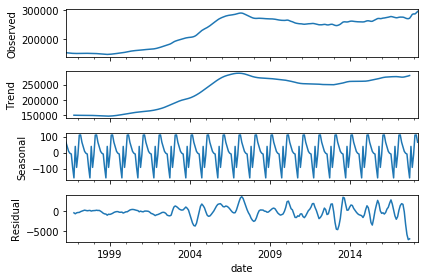

In [14]:
from statsmodels.tsa.seasonal import seasonal_decompose
ts = ts.asfreq('MS')
model = seasonal_decompose(ts)
model.plot();

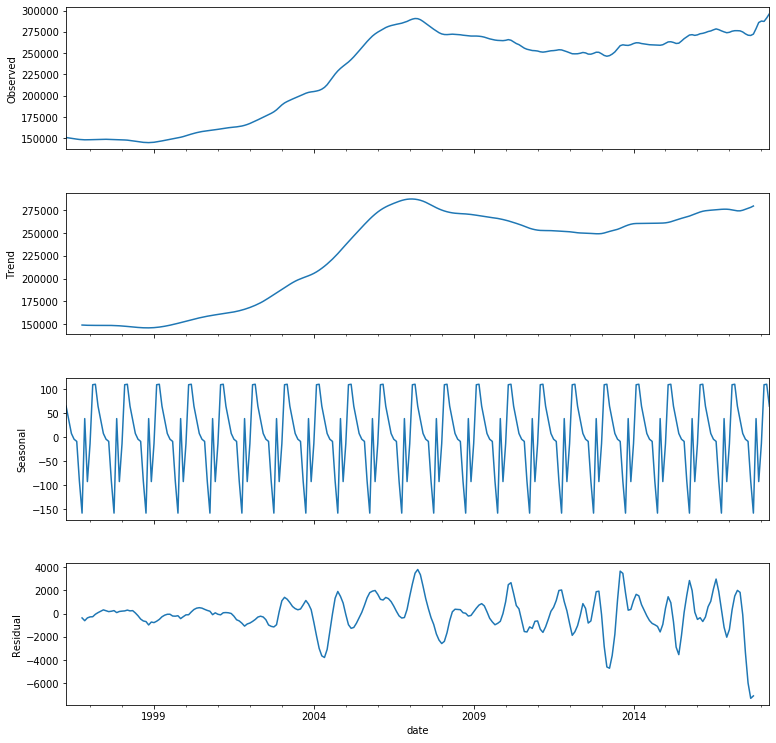

In [15]:
def seasonal_decomp_plot(ts,decomp_kws={},figwidth=12,figheight=12):
#     import statsmodels.api as sm
    from statsmodels.tsa.seasonal import seasonal_decompose
    decomp = seasonal_decompose(ts, **decomp_kws)
    # fig,ax = plt.subplots(figsize=(12,12))
    fig = decomp.plot()
    ax = fig.get_axes()
    fig = ax[0].get_figure()
    
    fig.set_figheight(figheight)
    fig.set_figwidth(figwidth)
    
    return decomp


    
decomp=seasonal_decomp_plot(ts)
# px.line(ts)
# decomp.nobs

In [16]:
decomp.resid.head(10)

date
1996-04-01           NaN
1996-05-01           NaN
1996-06-01           NaN
1996-07-01           NaN
1996-08-01           NaN
1996-09-01           NaN
1996-10-01   -375.677910
1996-11-01   -613.881373
1996-12-01   -374.595659
1997-01-01   -286.698834
Freq: MS, Name: MeanValue, dtype: float64

## stationarity check

In [17]:
## Lab Function
def stationarity_check(TS,plot=True,col=None):
    """From: https://learn.co/tracks/data-science-career-v2/module-4-a-complete-data-science-project-using-multiple-regression/working-with-time-series-data/time-series-decomposition
    """
    
    # Import adfuller
    from statsmodels.tsa.stattools import adfuller

    if col is not None:
        # Perform the Dickey Fuller Test
        dftest = adfuller(TS[col]) # change the passengers column as required 
    else:
        dftest=adfuller(TS)
 
    if plot:
        # Calculate rolling statistics
        rolmean = TS.rolling(window = 8, center = False).mean()
        rolstd = TS.rolling(window = 8, center = False).std()

        #Plot rolling statistics:
        fig = plt.figure(figsize=(12,6))
        orig = plt.plot(TS, color='blue',label='Original')
        mean = plt.plot(rolmean, color='red', label='Rolling Mean')
        std = plt.plot(rolstd, color='black', label = 'Rolling Std')
        plt.legend(loc='best')
        plt.title('Rolling Mean & Standard Deviation')
#     plt.show(block=False)
    
    # Print Dickey-Fuller test results
    print ('Results of Dickey-Fuller Test:')

    dfoutput = pd.Series(dftest[0:4],
                         index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key] = value
        
    dfoutput['sig'] = dfoutput['p-value']<.05
    print (dfoutput)
    
    return dfoutput

### Residuals

Results of Dickey-Fuller Test:
Test Statistic                  -3.761092
p-value                          0.003331
#Lags Used                      16.000000
Number of Observations Used    236.000000
Critical Value (1%)             -3.458366
Critical Value (5%)             -2.873866
Critical Value (10%)            -2.573339
sig                              1.000000
dtype: float64


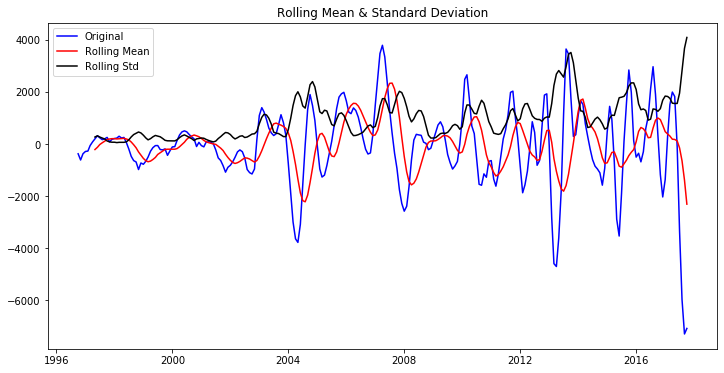

In [19]:
stationarity_check(decomp.resid.dropna());

#### Attempted Use of My BlockTimeSeriesSplitter class, but it failed

In [20]:
# from fsds_100719.jmi import BlockTimeSeriesSplit
# splitter = BlockTimeSeriesSplit(n_splits=5)
# # ts_train, ts_test = splitter.split(ts.dropna())
# # help(splitter)
# # s

## GridSearch with `pmdarima`

In [21]:
TEST_SIZE = 0.2
idx_split = np.int(len(ts.index)//TEST_SIZE)

ts_train = ts.iloc[:idx_split] 
ts_test = ts.iloc[idx_split:]

display(ts_train)#.style.set_caption('Training Data'))
display(ts_test)#.style.set_caption('Test Data'))

date
1996-04-01    150900.0
1996-05-01    150400.0
1996-06-01    149900.0
1996-07-01    149400.0
1996-08-01    149000.0
                ...   
2017-12-01    286000.0
2018-01-01    287700.0
2018-02-01    287300.0
2018-03-01    291400.0
2018-04-01    296300.0
Freq: MS, Name: MeanValue, Length: 265, dtype: float64

Series([], Freq: MS, Name: MeanValue, dtype: float64)

In [22]:
import pmdarima as pm

model = pm.auto_arima(ts_train.dropna(),
                     suppress_warnings=True,
                      stionarity=True)
model.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Statespace Model Results                           
==============================================================================
Dep. Variable:                      y   No. Observations:                  265
Model:               SARIMAX(1, 1, 1)   Log Likelihood               -2295.209
Date:                Sat, 21 Dec 2019   AIC                           4598.418
Time:                        21:00:17   BIC                           4612.722
Sample:                             0   HQIC                          4604.165
                                - 265                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept     83.9244     49.288      1.703      0.089     -12.678     180.527
ar.L1          0.8331      0.087      9.625      0.000       0.663       1.003
ma.L1         -0.8092      0.090     -9.034      0.000      -0.985      -0.634
sigma2      2.011e+06      0.006   3.52e+08      0.000    2.01e+06    2.01e+06
===================================================================================
Ljung-Box (Q):                      652.61   Jarque-Bera (JB):                94.46
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               2.82   Skew:                             0.88
Prob(H) (two-sided):                  0.00   Kurtosis:                         5.34
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
[2] Covariance matrix is singular or near-singular, with condition number 3.94e+23. Standard errors may be unstable.
"""

In [23]:
from statsmodels.tsa.statespace.sarimax import SARIMAX
model_sarimax = SARIMAX(decomp.resid.dropna(),**model.get_params()).fit()
model_sarimax.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Statespace Model Results                           
==============================================================================
Dep. Variable:              MeanValue   No. Observations:                  253
Model:               SARIMAX(1, 1, 1)   Log Likelihood               -1908.425
Date:                Sat, 21 Dec 2019   AIC                           3822.851
Time:                        21:00:17   BIC                           3833.439
Sample:                    10-01-1996   HQIC                          3827.111
                         - 10-01-2017                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5139      0.049     10.580      0.000       0.419       0.609
ma.L1          0.6692      0.046     14.461      0.000       0.579       0.760
sigma2      2.207e+05   1.47e+04     15.023      0.000    1.92e+05     2.5e+05
===================================================================================
Ljung-Box (Q):                      187.60   Jarque-Bera (JB):                47.55
Prob(Q):                              0.00   Prob(JB):                         0.00
Heteroskedasticity (H):               8.99   Skew:                            -0.42
Prob(H) (two-sided):                  0.00   Kurtosis:                         4.96
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

# 📓 BOOKMARK: GETTING PREDICTIONS

In [ ]:
# plt.plot(model.predict(ts_test))
# # plt.plot(type(ts_test))""

In [ ]:
# # preds = model_sarimax.predict(ts_test.index.to_series())
# preds

#### EARLIER EDA / INVESTIGATION

In [24]:
zip_list = list(df['RegionID'].unique())
zip_list[0]

84654

In [25]:
mpl.rcParams['figure.figsize'] = (12,6)
df_small = df.loc[df['RegionID'].isin(zip_list[:1000])]
df_small['datetime'] = df_small.index.to_series()
df_small

//anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,RegionID,RegionName,City,State,Metro,CountyName,SizeRank,Month,MeanValue,datetime
date,,,,,,,,,,
1996-04-01,84654,60657,Chicago,IL,Chicago,Cook,1,1996-04-01,334200.0,1996-04-01
1996-04-01,90668,75070,McKinney,TX,Dallas-Fort Worth,Collin,2,1996-04-01,235700.0,1996-04-01
1996-04-01,91982,77494,Katy,TX,Houston,Harris,3,1996-04-01,210400.0,1996-04-01
1996-04-01,84616,60614,Chicago,IL,Chicago,Cook,4,1996-04-01,498100.0,1996-04-01
1996-04-01,93144,79936,El Paso,TX,El Paso,El Paso,5,1996-04-01,77300.0,1996-04-01
...,...,...,...,...,...,...,...,...,...,...
2018-04-01,84633,60632,Chicago,IL,Chicago,Cook,1013,2018-04-01,166700.0,2018-04-01
2018-04-01,78983,48111,Van Buren,MI,Detroit,Wayne,1014,2018-04-01,190800.0,2018-04-01
2018-04-01,90629,75024,Plano,TX,Dallas-Fort Worth,Collin,1015,2018-04-01,414700.0,2018-04-01


In [43]:
def plotly_timesieres(df,x='datetime',y='MeanValue',color='RegionID',
                  line_group='State'):
    from plotly import express as px
    import plotly.graph_objects as go

    pfig = px.line(data_frame=df,x=x,y=y,color=color,
                  line_group=line_group)

    pfig.update_layout(title_text='Time Series with Rangeslider',
                      xaxis_rangeslider_visible=True)

    # Add range slider
    pfig.update_layout(
        xaxis=go.layout.XAxis(
            rangeselector=dict(
                buttons=list([
                    dict(count=1,
                         label="1m",
                         step="month",
                         stepmode="backward"),
                    dict(count=6,
                         label="6m",
                         step="month",
                         stepmode="backward"),
                    dict(count=1,
                         label="YTD",
                         step="year",
                         stepmode="todate"),
                    dict(count=1,
                         label="1y",
                         step="year",
                         stepmode="backward"),
                    dict(step="all")
                ])
            ),
            rangeslider=dict(
                visible=True
            ),
            type="date"
        )
    )
    return pfig
pfig= plotly_timesieres(df_small)
pfig


In [39]:
# from plotly import express as px
# import plotly.graph_objects as go

# pfig = px.line(data_frame=df_small,x='datetime',y='MeanValue',color='RegionID',
#               line_group='State')
# # pfig.update_layout({''})

# pfig.update_layout(title_text='Time Series with Rangeslider',
#                   xaxis_rangeslider_visible=True)

# # Add range slider
# pfig.update_layout(
#     xaxis=go.layout.XAxis(
#         rangeselector=dict(
#             buttons=list([
#                 dict(count=1,
#                      label="1m",
#                      step="month",
#                      stepmode="backward"),
#                 dict(count=6,
#                      label="6m",
#                      step="month",
#                      stepmode="backward"),
#                 dict(count=1,
#                      label="YTD",
#                      step="year",
#                      stepmode="todate"),
#                 dict(count=1,
#                      label="1y",
#                      step="year",
#                      stepmode="backward"),
#                 dict(step="all")
#             ])
#         ),
#         rangeslider=dict(
#             visible=True
#         ),
#         type="date"
#     )
# )

### Grabbing only 40 zips

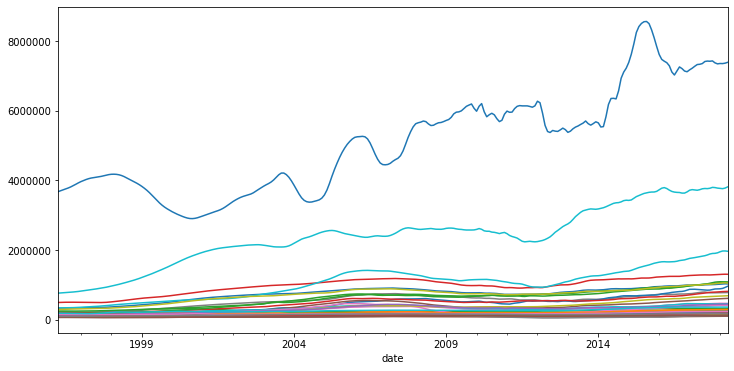

In [44]:
for i in range(0,40):
    df.groupby('RegionID').get_group(zip_list[i])['MeanValue'].plot(label=zip_list[i])
# plt.legend()

In [45]:
# i=0
# df.groupby('RegionID').get_group(zip_list[i])['MeanValue'].plot(label=zip_list[i])
# i+=1
# df.groupby('RegionID').get_group(zip_list[i])['MeanValue'].plot(label=zip_list[i])
# plt.legend()

### By State: IL

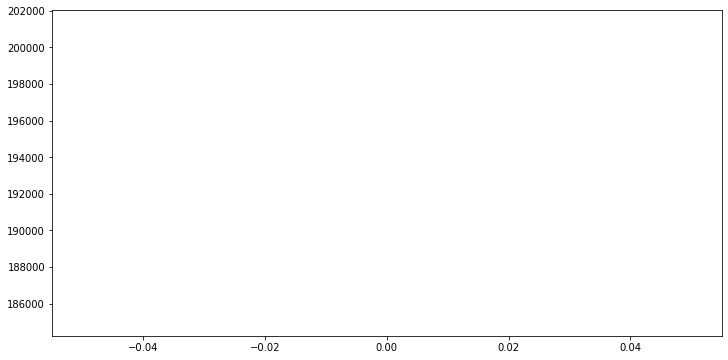

In [46]:
df_IL = df.groupby('State').get_group('IL')

il_grps = df_IL.groupby('RegionID').groups
# il_grps.keys()
for grp,rows in il_grps.items():
    plt.plot(df_IL.loc[rows,'MeanValue'].mean())

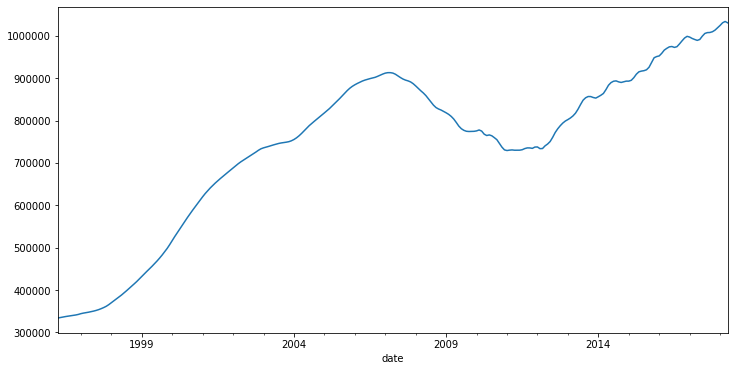

In [47]:
df.loc[df['RegionID']==zip_list[0],'MeanValue'].plot()

In [ ]:
fs.jmi.in

In [33]:
# state_zips = df.groupby(['State','RegionID']).groups

In [ ]:
# zips = df.groupby('RegionID').groups #pd.Grouper(freq='MS')]).groups
# len(zips.keys())

# list_zips = list(zips.keys())
# list_zips[:10]

In [ ]:
# zip_dict={}
# for zipcode in list_zips[:10]:
#     zip_dict[zipcode] = df.loc[zips[zipcode]]

In [ ]:
mpl.rcParams['figure.figsize'] = (12,6)
ax = zip_dict[58196]['MeanValue'].loc['2012':'2016'].resample('MS').plot();

In [ ]:
df.info()

In [ ]:
from pandas_profiling import ProfileReport
ProfileReport(df)

In [ ]:
# def melt_data(df): # BAD PROVIDED FUNCTION
#     melted = pd.melt(df, id_vars=['RegionName', 'City', 'State', 'Metro', 'CountyName'], var_name='time')
#     melted['time'] = pd.to_datetime(melted['time'], infer_datetime_format=True)
#     melted = melted.dropna(subset=['value'])
#     return melted.groupby('time').aggregate({'value':'mean'})

# melt_df = melt_data(df)

# Step 2: Data Preprocessing

In [ ]:
def get_datetimes(df):
    return pd.to_datetime(df.columns.values[1:], format='%Y-%m')

In [ ]:
date_cols =  df.columns.values[7:]
date_cols = pd.to_datetime(date_cols,format='%Y-%m')

new_cols_names = list(df.columns)[:7]
new_cols_names.extend(date_cols)
df.columns = new_cols_names
df

In [ ]:
melted = pd.melt(df, id_vars=['RegionName', 'City', 'State', 'Metro', 'CountyName'], var_name='time')
melted
# melted['time'] = pd.to_datetime(melted['time'], infer_datetime_format=True)


In [ ]:
df


# Step 3: EDA and Visualization

In [ ]:
font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 22}

matplotlib.rc('font', **font)

# NOTE: if you visualizations are too cluttered to read, try calling 'plt.gcf().autofmt_xdate()'!

# Step 4: Reshape from Wide to Long Format

In [ ]:
def melt_data(df):
    melted = pd.melt(df, id_vars=['RegionName', 'City', 'State', 'Metro', 'CountyName'], var_name='time')
    melted['time'] = pd.to_datetime(melted['time'], infer_datetime_format=True)
    melted = melted.dropna(subset=['value'])
    return melted.groupby('time').aggregate({'value':'mean'})

# Step 5: ARIMA Modeling

# Step 6: Interpreting Results